# Integration of myofiber single-nuclei data from Perez et al

In [1]:
import sys

import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

import scanpy as sc
import scvi

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all" # to show output from all the lines in a cells
pd.set_option('display.max_column',None) # display all the columns in pandas
pd.options.display.max_rows = 100

from datetime import date
today = str(date.today())

import matplotlib
from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42
sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 150, vector_friendly = True, format = 'pdf')

%cd /nfs/team205/vk8/processed_data/muscle/data_v3
import scrublet as scr
from doublet_detection import *

#myonuclei_res_folder = '/nfs/team205/vk8/scripts/scvi/Results/SKM_myonuclei/'

/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/pytorch_lightning/metrics/__init__.py:44: LightningDeprecationWarning: `pytorch_lightning.metrics.*` module has been renamed to `torchmetrics.*` and split off to its own package (https://github.com/PyTorchLightning/metrics) since v1.3 and will be removed in v1.5
  "`pytorch_lightning.metrics.*` module has been renamed to `torchmetrics.*` and split off to its own package"
Global seed set to 0


/nfs/team205/vk8/processed_data/muscle/data_v3


In [2]:
data_file = "/nfs/team205/vk8/processed_data/muscle/data_v3/Perez21"

In [3]:
figures = '/nfs/team205/vk8/scripts/scvi/SKM_analyses_rev1/figures'
tables = '/nfs/team205/vk8/scripts/scvi/SKM_analyses_rev1/tables'

In [5]:
model_folder = '/nfs/team205/vk8/scripts/scvi/Results/scvi_models/'

!pip install scrublet

## Import the data

In [3]:
metadata = pd.read_table(f'{data_file}/GSE167186-GPL24676_series_matrix.txt',  skiprows=30)

In [4]:
metadata.index = metadata['!Sample_title']
metadata.drop (columns ='!Sample_title', inplace = True)
metadata = metadata.T.copy()
subset_meta = metadata[['!Sample_geo_accession', '!Sample_description', '!Sample_characteristics_ch1', '!Sample_supplementary_file_1']]
subset_meta.columns = ['SampleID', 'Sample', 'Batch', 'Age_group', 'Tissue', 'Age', 'Filename'] 

In [5]:
subset_meta.loc[:,'Filename'] = [i.split('/')[8] for i in subset_meta['Filename']].copy()
subset_meta.loc[:,'Age_group'] = [i.strip("group: ") for i in subset_meta['Age_group']].copy()
subset_meta.loc[:,'Age'] = [i.strip("age: ") for i in subset_meta['Age']].copy()
subset_meta.loc[:,"Tissue"] = [i.lstrip("tissue: ") for i in subset_meta['Tissue']].copy()

/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/pandas/core/indexing.py:1843: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item_labels[indexer[info_axis]]] = value


In [7]:
subset_meta[['SampleID', 'Filename']].to_csv("Perez2022_metadata.csv")

In [8]:
subset_meta

,SampleID,Sample,Batch,Age_group,Tissue,Age,Filename
OldHM1,GSM5098737,HM1,Single-nuclei RNA-seq,Old,Skeletal muscle,75,GSM5098737_HM1.csv.gz
OldHM2,GSM5098738,HM2,Single-nuclei RNA-seq,Old,Skeletal muscle,76,GSM5098738_HM2.csv.gz
OldHM3,GSM5098739,HM3,Single-nuclei RNA-seq,Old,Skeletal muscle,75,GSM5098739_HM3.csv.gz
OldHM4,GSM5098740,HM4,Single-nuclei RNA-seq,Old,Skeletal muscle,79,GSM5098740_HM4.csv.gz
YouHM5,GSM5098741,HM5,Single-nuclei RNA-seq,Youn,Skeletal muscle,20,GSM5098741_HM5.csv.gz
OldHM6,GSM5098742,HM6,Single-nuclei RNA-seq,Old,Skeletal muscle,82,GSM5098742_HM6.csv.gz
OldHM7,GSM5098743,HM7,Single-nuclei RNA-seq,Old,Skeletal muscle,72,GSM5098743_HM7.csv.gz
YouHM8,GSM5098744,HM8,Single-nuclei RNA-seq,Youn,Skeletal muscle,21,GSM5098744_HM8.csv.gz
OldHM9,GSM5098745,HM9,Single-nuclei RNA-seq,Old,Skeletal muscle,70,GSM5098745_HM9.csv.gz
YouHM10,GSM5098746,HM10,Single-nuclei RNA-seq,Youn,Skeletal muscle,21,GSM5098746_HM10.csv.gz


In [9]:
starsolo_path = "/nfs/team205/vk8/irods_data/04_downloads_muscAge/starsolo/Perez2022"
cellbender_path = "/nfs/team205/vk8/irods_data/04_downloads_muscAge/cellbender_150epochs"
velo_path = '/nfs/team205/vk8/irods_data/04_downloads_muscAge/starsolo/Perez2022/GSM5098739/logs/Velocyto'

features = pd.read_csv('/nfs/team205/vk8/irods_data/04_downloads_muscAge/starsolo/Perez2022/GSM5098739/logs/GeneFull/filtered/features.tsv.gz',\
                      sep = '\t', header = None)

features.loc[:,2]= 'Gene Expression'

features.to_csv('/nfs/team205/vk8/irods_data/04_downloads_muscAge/starsolo/Perez2022/GSM5098739/logs/GeneFull/filtered/features.tsv.gz', 
                   header=False, index=False, sep = '\t')

In [10]:
def gather_matrices(sid, starsolo_path, cellbender_path, batch_type = 'cells'):
    if batch_type == 'cells':
        cr_gene_filtered_mtx = f"{starsolo_path}/{sid}/logs/Gene/filtered"
    else:
        cr_gene_filtered_mtx = f"{starsolo_path}/{sid}/logs/GeneFull/filtered"
#    cr_velo_filtered_mtx = f"{starsolo_path}/{sid}/logs/Velocyto/filtered"
    cb_filtered_h5 = f"{cellbender_path}/{sid}/{sid}_filtered.h5"

    cr_gene_filtered_ad = sc.read_10x_mtx(cr_gene_filtered_mtx)
    print("cr_gene_filtered_mtx done")
#    cr_velo_filtered_ad = sk.read_velocyto(cr_velo_filtered_mtx)
#    print("cr_velo_filtered_mtx done")
    cb_gene_filtered_ad = sk.read_10X_h5(cb_filtered_h5)
    print("cb_filtered_h5 done")

    common_cells = list(
        set(cr_gene_filtered_ad.obs_names.tolist()) & set(cb_gene_filtered_ad.obs_names.tolist()))
    k_cr = cr_gene_filtered_ad.obs_names.isin(common_cells)
    k_cb = cb_gene_filtered_ad.obs_names.isin(common_cells)
    ad = sc.AnnData(
        X=cb_gene_filtered_ad.X[np.where(k_cb)[0], :],
        obs=cb_gene_filtered_ad.obs[k_cb].copy(),
        var=cb_gene_filtered_ad.var.copy(),
        layers={
            "raw": cr_gene_filtered_ad.X[np.where(k_cr)[0], :],
#            "spliced": cr_velo_filtered_ad.X[np.where(k_vel)[0]],
#            "unspliced": cr_velo_filtered_ad.layers["unspliced"][np.where(k_vel)[0]],
#            "ambiguous": cr_velo_filtered_ad.layers["ambiguous"][np.where(k_vel)[0]],
        },
    )
    ad.var.rename(columns = {'gene_ids':'ENSEMBL'}, inplace = True)
    ad.var['SYMBOL'] = ad.var.index
    ad.var_names_make_unique() 
    ad.obs['SampleID'] = sid
    ad.obs['barcode'] = ad.obs_names
    ad.obs_names = ad.obs['SampleID']+"-"+ad.obs['barcode']
#    for layer in ("spliced", "unspliced", "ambiguous"):
#        ad.layers[layer].eliminate_zeros()
    return ad

In [11]:
def AnnData_from_files_v1(file_path, meta):
    #Writing output from separate samples, processed using CellRanger, into a dictionary of Scanpy objects:
    import os.path
    import scipy.sparse as sparse
    ad = []
    #Generate AnnData for each sample
    for file in meta['Filename']:
        path = file_path+file
        if os.path.isfile(path):
            X = pd.read_csv(path, index_col = 0)
            sample = sc.AnnData(X.T)
            sample.X = sparse.csr_matrix(sample.X).copy()
            sample.var['SYMBOL'] = sample.var.index
            #sample.var_names_make_unique() 
            sample.obs['SampleID'] = meta.loc[meta['Filename'] == file, 'SampleID'].values[0]
            sample.obs['barcode'] = sample.obs_names
            sample.obs_names = sample.obs['SampleID']+"-"+sample.obs['barcode']
            ad.append(sample)
            print(f"{file} has been read")
        else:
            print(f"{file} doesn't exist")
    from anndata import AnnData
    adata = ad[0].concatenate (ad[1:], batch_key = 'concat_sample_no', index_unique = None)
    #Add cleaned metadata to the Anndata.obs table
    obs_merged = pd.merge(left = adata.obs, right = meta, how = "left", left_on="SampleID", right_on="SampleID")
    obs_merged.index = obs_merged['SampleID']+"-"+obs_merged['barcode']
    adata.obs = obs_merged
    return adata

In [13]:
def AnnData_from_files_v2(samples, starsolo_path, cellbender_path, meta):
    #Writing output from separate samples, processed using CellRanger, into a dictionary of Scanpy objects:
    import numpy as np
    from scipy import sparse
    ad = []
    #Generate AnnData for each sample
    for sid in samples:
        cr_filt_path = f"{starsolo_path}/{sid}/logs/GeneFull/filtered"
        cr_velo_path = f"{starsolo_path}/{sid}/logs/Velocyto/raw"
        cb_filt_path = f"{cellbender_path}/{sid}/{sid}_filtered.h5"
        feature_check_correct(sample = sid, feature_path=cr_filt_path)
        feature_check_correct(sample = sid, feature_path=cr_velo_path)
        
        cr_gene_filtered_ad = sc.read_10x_mtx(cr_filt_path)
        print("cr_gene_filtered_mtx read")
        cb_gene_filtered_ad = sc.read_10x_h5(cb_filt_path)
        print("cb_filtered_h5 read")
        
        velocyto_ad = sc.read_10x_mtx(cr_velo_path)
        print("Incorrect velocyto is read")
        shapex = np.loadtxt(f'{cr_velo_path}/matrix.mtx', skiprows=2, max_rows = 1, delimiter=' ')[0:2].astype(int)
        mtx = np.loadtxt(f'{cr_velo_path}/matrix.mtx', skiprows=3, delimiter=' ')
        spliced = sc.AnnData(X = sparse.csr_matrix((mtx[:,2], (mtx[:,0]-1, mtx[:,1]-1)), shape = shapex).T, 
                             dtype = 'float32', obs = velocyto_ad.obs, var = velocyto_ad.var)
        unspliced = sc.AnnData(X = sparse.csr_matrix((mtx[:,3], (mtx[:,0]-1, mtx[:,1]-1)), shape = shapex).T, 
                              dtype = 'float32', obs = velocyto_ad.obs, var = velocyto_ad.var)
        ambiguous = sc.AnnData(X = sparse.csr_matrix((mtx[:,4], (mtx[:,0]-1, mtx[:,1]-1)), shape = shapex).T, 
                              dtype = 'float32', obs = velocyto_ad.obs, var = velocyto_ad.var)
        print("velocyto mtx done")

        common_cells = list(
            set(cr_gene_filtered_ad.obs_names.tolist()) & set(cb_gene_filtered_ad.obs_names.tolist()))
        
        ad1 = sc.AnnData(
            X=cb_gene_filtered_ad[common_cells, :].X,
            obs=cb_gene_filtered_ad.obs.loc[common_cells,:].copy(),
            var=cb_gene_filtered_ad.var.copy(),
            layers={
                "raw": cr_gene_filtered_ad[common_cells, :].X,
                "spliced": spliced[common_cells, :].X,
                "unspliced": unspliced[common_cells, :].X,
                "ambiguous": ambiguous[common_cells, :].X,
            },
        )
        ad1.var.rename(columns = {'gene_ids':'ENSEMBL'}, inplace = True)
        ad1.var['SYMBOL'] = ad1.var.index
        ad1.var_names_make_unique() 
        ad1.obs['SampleID'] = sid
        ad1.obs['barcode'] = ad1.obs_names
        ad1.obs_names = ad1.obs['SampleID']+"-"+ad1.obs['barcode']
        ad.append(ad1)
        print(f"{sid} anndata created")
    from anndata import AnnData
    adata = ad[0].concatenate (ad[1:], batch_key = 'concat_sample_no', index_unique = None)
    #Add cleaned metadata to the Anndata.obs table
    obs_merged = pd.merge(left = adata.obs, right = meta, how = "left", left_on="SampleID", right_on="SampleID")
    obs_merged.index = obs_merged['SampleID']+"-"+obs_merged['barcode']
    adata.obs = obs_merged
    return adata

In [14]:
subset_meta['SampleID'].tolist()

['GSM5098737',
 'GSM5098738',
 'GSM5098739',
 'GSM5098740',
 'GSM5098741',
 'GSM5098742',
 'GSM5098743',
 'GSM5098744',
 'GSM5098745',
 'GSM5098746',
 'GSM5098747',
 'GSM5098748',
 'GSM5098749',
 'GSM5098750',
 'GSM5098751',
 'GSM5098752',
 'GSM5098753']

In [ ]:
%%time
adata = AnnData_from_files_v2(samples = subset_meta['SampleID'].tolist(), 
                             starsolo_path = "/nfs/team205/vk8/irods_data/04_downloads_muscAge/starsolo/Perez2022", 
                            cellbender_path = "/nfs/team205/vk8/irods_data/04_downloads_muscAge/cellbender_150epochs", 
                              meta = subset_meta)

cr_gene_filtered_mtx read


/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/scanpy/readwrite.py:279: FutureWarning: X.dtype being converted to np.float32 from uint32. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  genome=dsets['genome'].astype(str),
/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


cb_filtered_h5 read
Incorrect velocyto is read
velocyto mtx done


/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


GSM5098737 anndata created
cr_gene_filtered_mtx read


/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


cb_filtered_h5 read


In [ ]:
def AddMetadata (sample_object, velocyto, cellbender):
    sample_object.obs['n_counts'] = np.sum(sample_object.X, axis = 1).A1
    if cellbender:
        sample_object.obs['n_counts_raw'] = np.sum(sample_object.layers['raw'], axis = 1).A1
        sample_object.obs["percent_soup"] = (1 - (sample_object.obs["n_counts"] / sample_object.obs["n_counts_raw"]))* 100
    if velocyto:
        sample_object.obs['n_counts_spliced'] = np.sum(sample_object.layers['spliced'], axis = 1).A1
        sample_object.obs['n_counts_unspliced'] = np.sum(sample_object.layers['unspliced'], axis = 1).A1
        sample_object.obs["percent_spliced"] = (sample_object.obs["n_counts_spliced"]/
                                                (sample_object.obs["n_counts_spliced"] + sample_object.obs["n_counts_unspliced"]))* 100
    sample_object.obs['n_genes'] = np.sum(sample_object.X > 0, axis = 1).A1
    mito_genes = sample_object.var_names.str.startswith('MT-')
    ribo_genes = (sample_object.var_names.str.startswith('RPS')|sample_object.var_names.str.startswith('RPL'))
    hb_genes = sample_object.var_names.str.startswith('HB')
    sample_object.obs['percent_mito'] = np.sum(sample_object[:, mito_genes].X, axis = 1) / np.sum(sample_object.X, axis = 1)
    sample_object.obs['percent_ribo'] = np.sum(sample_object[:, mito_genes].X, axis = 1) / np.sum(sample_object.X, axis = 1)
    sample_object.obs['percent_hb'] = np.sum(sample_object[:, hb_genes].X, axis = 1) / np.sum(sample_object.X, axis = 1)
    sample_object.var['n_counts'] = np.sum(sample_object.X, axis = 0).A1
    sample_object.var['n_cells'] = np.sum(sample_object.X>0, axis = 0).A1

In [18]:
AddMetadata (adata, velocyto = True, cellbender = True)

In [ ]:
adata.write(f"SKM_nuclei_Perez2022_raw_all_slots_{today}.h5ad")

In [28]:
adata.obs['percent_soup'].mean()

8.397318

In [30]:
adata.obs.loc[adata.obs['SampleID'] == 'GSM5098740','percent_soup'].mean()

13.557444

In [4]:
import os 
os.getcwd()

'/nfs/team205/vk8/processed_data/muscle/data_v3'

## Load adata & run QC on the data

In [3]:
%%time
skm_nuclei_qc = sc.read("SKM_nuclei_Perez2022_raw_all_slots_{today}.h5ad")

CPU times: user 1.74 s, sys: 10.5 s, total: 12.3 s
Wall time: 21.8 s


In [4]:
del skm_nuclei_qc.layers

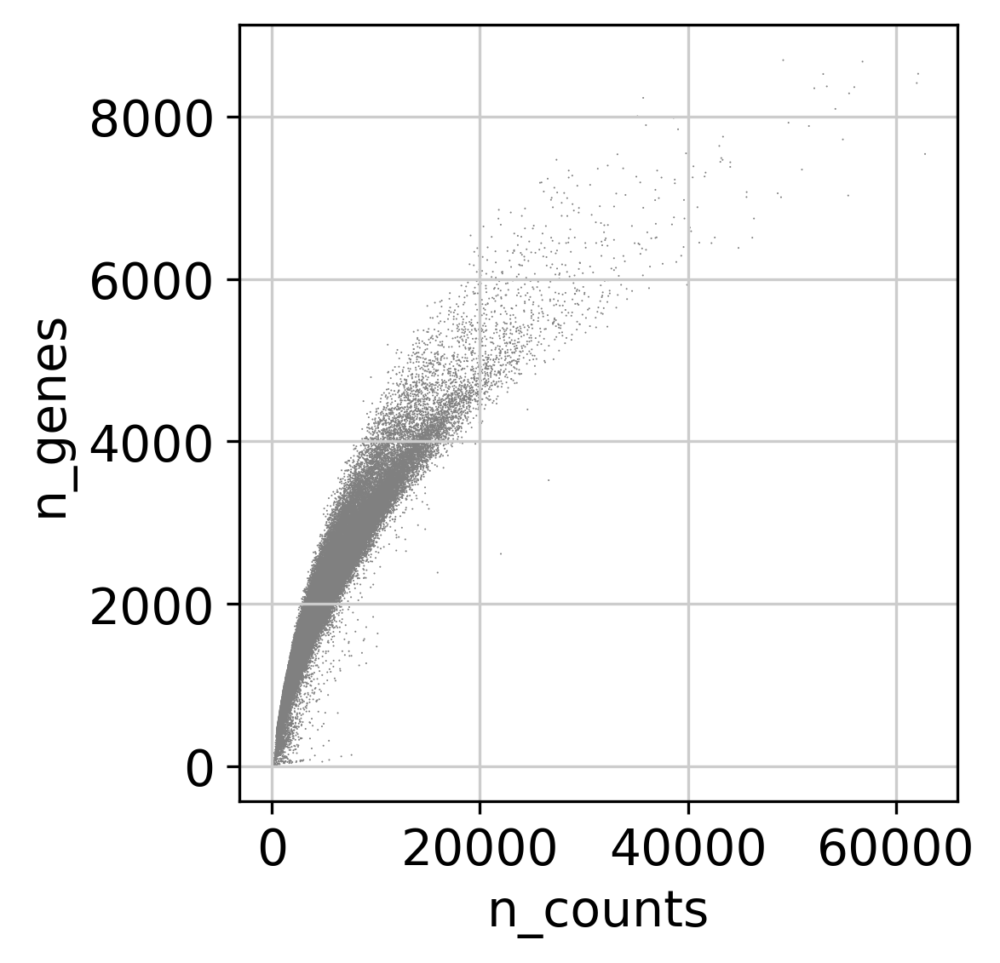

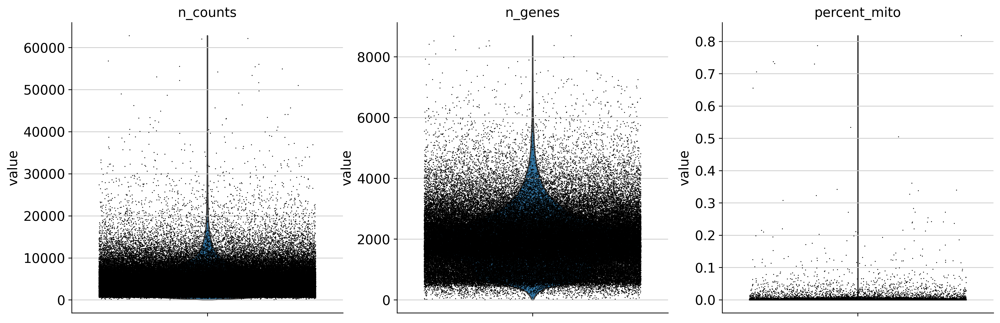

In [5]:
sc.pl.scatter(skm_nuclei_qc, x='n_counts', y='n_genes')
sc.pl.violin(skm_nuclei_qc, ['n_counts', 'n_genes', 'percent_mito'],
             jitter=0.4, multi_panel=True)

In [6]:
# Filter raw cells according to identified QC thresholds:
print('Total number of cells: {:d}'.format(skm_nuclei_qc.n_obs))

sc.pp.filter_cells(skm_nuclei_qc, min_counts = 500)
print('Number of cells after min count filter: {:d}'.format(skm_nuclei_qc.n_obs))

sc.pp.filter_cells(skm_nuclei_qc, max_counts = 40000)
print('Number of cells after max count filter: {:d}'.format(skm_nuclei_qc.n_obs))

sc.pp.filter_cells(skm_nuclei_qc, min_genes = 400)
print('Number of cells after min genes filter: {:d}'.format(skm_nuclei_qc.n_obs))

sc.pp.filter_cells(skm_nuclei_qc, max_genes = 5000)
print('Number of cells after max genes filter: {:d}'.format(skm_nuclei_qc.n_obs))

skm_nuclei_qc = skm_nuclei_qc[skm_nuclei_qc.obs['percent_mito'] < 0.05]
print('Number of cells after mito filter: {:d}'.format(skm_nuclei_qc.n_obs))

Total number of cells: 125035
Number of cells after min count filter: 124819
Number of cells after max count filter: 124778
Number of cells after min genes filter: 123921
Number of cells after max genes filter: 123112
Number of cells after mito filter: 122972


In [7]:
skm_nuclei_qc = doublet_detection(sample_object = skm_nuclei_qc, sample_col = 'SampleID', return_anndata = True)

(122972, 3)


In [8]:
np.mean(skm_nuclei_qc.obs['is_doublet'])
np.mean(skm_nuclei_qc.obs['scrublet_score']>0.4)

0.07797710047815763

0.033267735744722374

In [9]:
skm_nuclei_qc.layers["counts"] = skm_nuclei_qc.X.copy()
sc.pp.normalize_total(skm_nuclei_qc, target_sum=1e4)
sc.pp.log1p(skm_nuclei_qc)

In [10]:
adata = skm_nuclei_qc.copy()

In [11]:
#List of genes /nfs/team205/vk8/processed_data/regev_lab_cell_cycle_genes.txt
cell_cycle_genes = [x.strip() for x in open('/nfs/team205/vk8/processed_data/regev_lab_cell_cycle_genes.txt')]

s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
cell_cycle_genes = [x for x in cell_cycle_genes if x in skm_nuclei_qc.var_names]

sc.pp.scale(skm_nuclei_qc)
sc.tl.score_genes_cell_cycle(skm_nuclei_qc, s_genes, g2m_genes)

In [12]:
adata.obs[['S_score', 'G2M_score', 'phase']] = skm_nuclei_qc.obs[['S_score', 'G2M_score', 'phase']].copy()

adata.obs['Age_group'].cat.categories = ['old', 'young']

In [13]:
adata.write(f"SKM_nuclei_Perez2022_raw_qc_{today}.h5ad")

# Run scvi

In [3]:
adata = sc.read("SKM_nuclei_Perez2022_raw_qc_2023-05-05.h5ad")

In [4]:
general_mrkrs = [ 'MYH7', 'TNNT1', 'TNNT3', 'MYH1', 'MYH2', "CKM", "MB", # Myofibers
           'PAX7', 'DLK1', # MuSCs
           'PDGFRA', 'DCN', 'ANGPTL7', 'OSR2', 'NGFR', 'SLC22A3','ITGA6', # Fibroblasts
           'FMOD', 'TNMD' ,  'MKX', # Tenocytes
 'MPZ', 'MBP',  # Schwann cells
'CDH2', 'L1CAM', # SCG
'MSLN', 'ITLN1', # mesothelium
"ADIPOQ", "PLIN1", # adipocytes
'PTPRC', 'CD3D', 'IL7R', # T cells
'NKG7', 'PRF1', #NK cells
'CD79A', "TCL1A",  # B cells
'MZB1', 'JCHAIN', # B plasma 
"CD14", "FCGR3A",'S100A8', 'S100A12', # Mono
"CD163", "C1QA", # Macrop
"XCR1", "CLEC9A", # cDC1 "CADM1",
"CD1C", "CLEC10A", "CCR7", # cDC2
'LILRA4', 'IL3RA', "IRF7",  # pDC 
'FCGR3B', 'CSF3R', 'SORL1',  # Neutrophils
'EPX', 'PRG2', # Eosinophils 'CLC'
'TPSB2', 'MS4A2', # Mast cells
'PECAM1', 'HEY1','CLU', # art EC
'CA4', 'LPL', # capEC
'ACKR1', 'SELE', # venEC
'LYVE1', 'TFF3',  # lymphEC
'RGS5','ABCC9', # pericytes           
'MYH11', 'ACTA2', # SMC
'HBA1', #RBC
    ]
myofiber_mrkrs = ['TNNT1', 'MYH7', 'TNNT3', 'MYH1', 'MYH2', 
                 "CKM", "MB", "COX6C", # cytoplasmic populations
                'FAM189A2', 'KHDRBS3','NAMPT', 'SOCS3', 'STAT3', # FAM189A2 population
                'OTUD1','CREB5', 'ATF3', 'XIRP1','ENAH', 'FLNC', 'DNAJA4', #'BDNF',  # 'NRAP', 'ANKRD1', 'XIRP2',  # OTUD1 population 
                    'TNFRSF12A',
                   'MUSK', 'ACHE', 'VMO1', 'PLCB4',  #NMJ
                    'NCAM1', 'MAML2', 'SNX7', # MTJ
                 'SORBS2', 'EFNA5', 'BMPR1B', 'GRIA2', 'STYK1', # SORBS2 population
                   'ACTC1', 'UCHL1', 'RGCC', 'MLLT11', # UCHL1 population
                    'MYOG', 'TNNT2', # TNNT2 population
                     'CDKN1A', 'ADIRF', 'SAA1',  'MYH8', # MYH8 populations 'MYOD1',
                   'FLCN', 'FNIP1', 'RASA4']

In [7]:
def run_scvi(adata, batch_hv = "Age_group", batch_scvi = "SampleID", \
             cat_cov_scvi = ["DonorID", "10X_version", "Sex", "Age_group"], cont_cov_scvi = ["percent_mito"], \
             include_genes = [], exclude_cc_genes=True, exclude_mt_genes = True, vae_name = "", **kwargs):
    adata_scvi = sc.AnnData(X = adata.layers['counts'].copy(), obs = adata.obs.copy(), var = adata.var.copy())
    #adata_scvi.layers["counts"] = adata_scvi.X.copy()
    #sc.pp.normalize_total(adata_scvi, target_sum=1e4)
    #sc.pp.log1p(adata_scvi)
     # keep full dimension safe
#    sc.pp.highly_variable_genes(adata_scvi, flavor="seurat_v3", n_top_genes=10000, layer="counts",\
#                                batch_key="Age_group")
    sc.pp.highly_variable_genes(adata_scvi, flavor="seurat_v3", n_top_genes=10000,batch_key=batch_hv)
    selected_genes = list(set(adata_scvi.var.loc[adata_scvi.var['highly_variable']].index.tolist()+ include_genes))
    print(len(selected_genes))
    if exclude_cc_genes:
        cell_cycle_genes = [x.strip() for x in open('/nfs/team205/vk8/processed_data/regev_lab_cell_cycle_genes.txt')]
        [selected_genes.remove(i) for i in cell_cycle_genes if i in selected_genes]
    if exclude_mt_genes:
        mt_genes = adata.var_names[adata.var_names.str.startswith('MT-')]
        [selected_genes.remove(i) for i in mt_genes if i in selected_genes]
        
    adata_scvi = adata_scvi[:, selected_genes].copy()
    scvi.model.SCVI.setup_anndata(adata_scvi, batch_key=batch_scvi, \
                             categorical_covariate_keys=cat_cov_scvi, \
                             continuous_covariate_keys=cont_cov_scvi)
    scvi_kwargs = {k: v for k,v in kwargs.items() if k in scvi.model.SCVI.__init__.__code__.co_varnames}
    vae = scvi.model.SCVI(adata_scvi, **scvi_kwargs)
    train_kwargs = {k: v for k,v in kwargs.items() if k in vae.train.__code__.co_varnames}
    vae.train(**train_kwargs)
   # adata_scvi.obsm["X_scVI"] = vae.get_latent_representation()
 #   adata_raw_scvi = adata.copy()
    adata_scvi.obsm["X_scVI"] = vae.get_latent_representation()
    sc.pp.neighbors(adata_scvi, use_rep="X_scVI")
    sc.tl.leiden(adata_scvi)
#   sc.tl.umap(adata_scvi)
    sc.tl.umap(adata_scvi)    
    
    adata_raw_scvi = adata.copy()
    adata_raw_scvi.obsm['X_scVI'] = adata_scvi.obsm['X_scVI'].copy()
    adata_raw_scvi.obsm['X_umap'] = adata_scvi.obsm['X_umap'].copy()
    adata_raw_scvi.obsp = adata_scvi.obsp.copy()
    adata_raw_scvi.obs['leiden'] = adata_scvi.obs['leiden'].copy()
    
    sc.pl.umap(
        adata_raw_scvi,
        color=["Age_group"],
        frameon=False,
        ncols=2,
    )
    sc.pl.umap(
        adata_raw_scvi,
        color=['n_counts', "percent_soup", "percent_spliced", 'percent_mito', 'percent_ribo', 'percent_hb', \
               'scrublet_score', 'is_doublet'])
    cat_cov_str = "-".join(cat_cov_scvi)
#    vae.save(f"/nfs/team205/vk8/scripts/scvi/Results/scvi_models/{vae_name}_scvi_batch{batch_scvi}_cat{cat_cov_str}_cont{cont_cov_scvi}_10000hvgenes_{today}", save_anndata = True)
    results = {}
    results['data'] = adata_raw_scvi
    results['vae'] = vae
    return(results)

10008
INFO     Using batches from adata.obs["SampleID"]                                            
INFO     No label_key inputted, assuming all cells have same label                           
INFO     Using data from adata.X                                                             
INFO     Successfully registered anndata object containing 122972 cells, 9961 vars, 17       
         batches, 1 labels, and 0 proteins. Also registered 1 extra categorical covariates   
         and 1 extra continuous covariates.                                                  
INFO     Please do not further modify adata until model is trained.                          


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 300/300: 100%|██████████| 300/300 [55:50<00:00, 11.17s/it, loss=1.59e+03, v_num=1]


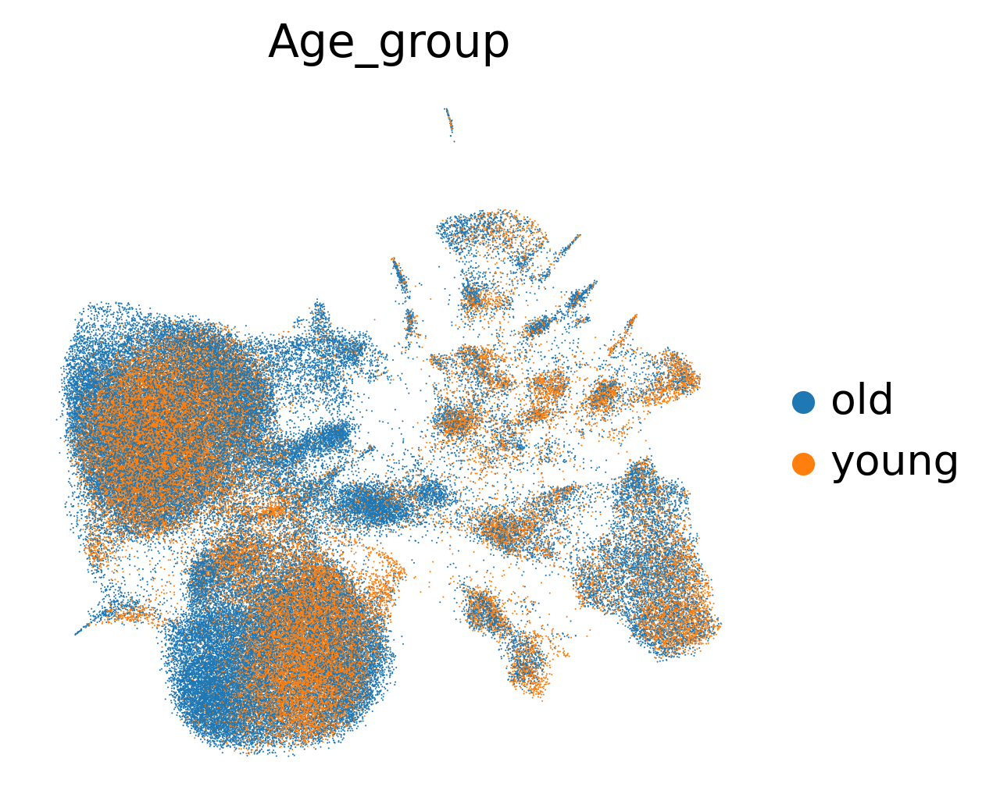

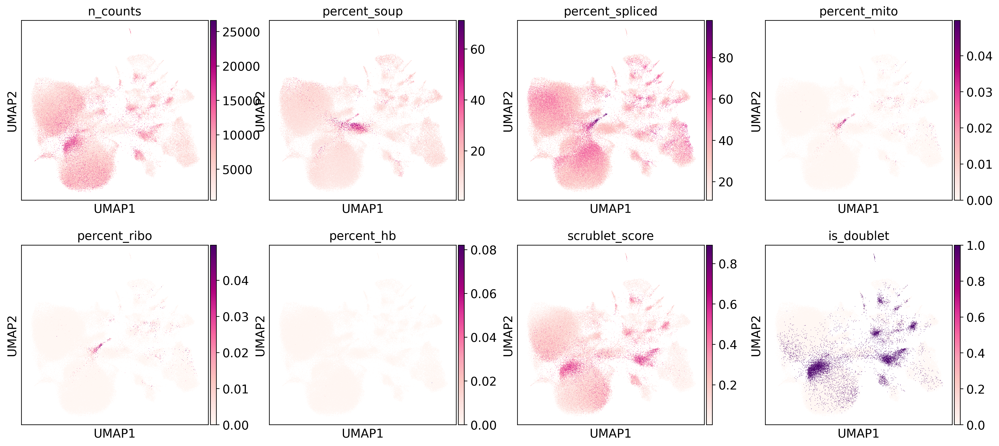

In [8]:
scvi_run = run_scvi(adata, batch_hv = "Age_group", batch_scvi = "SampleID", \
             cat_cov_scvi = ["Age_group"], cont_cov_scvi = ["percent_mito"], \
             include_genes = myofiber_mrkrs, exclude_cc_genes=True, exclude_mt_genes = True,
             vae_name = "Myofiber_nuclei_Perez", n_layers=2, n_latent=30, max_epochs=300)

In [9]:
adata_scvi = scvi_run['data']

In [17]:
vae = scvi_run['vae']

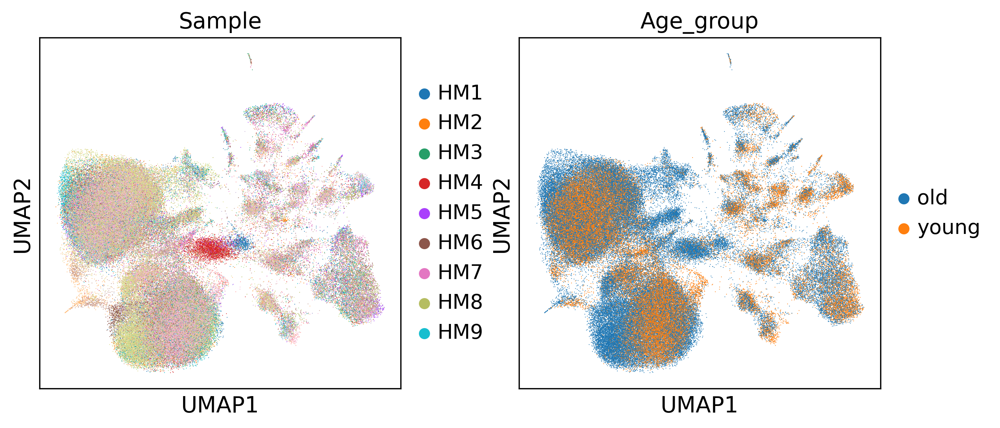

In [10]:
sc.pl.umap(adata_scvi, color = ['Sample', 'Age_group'])

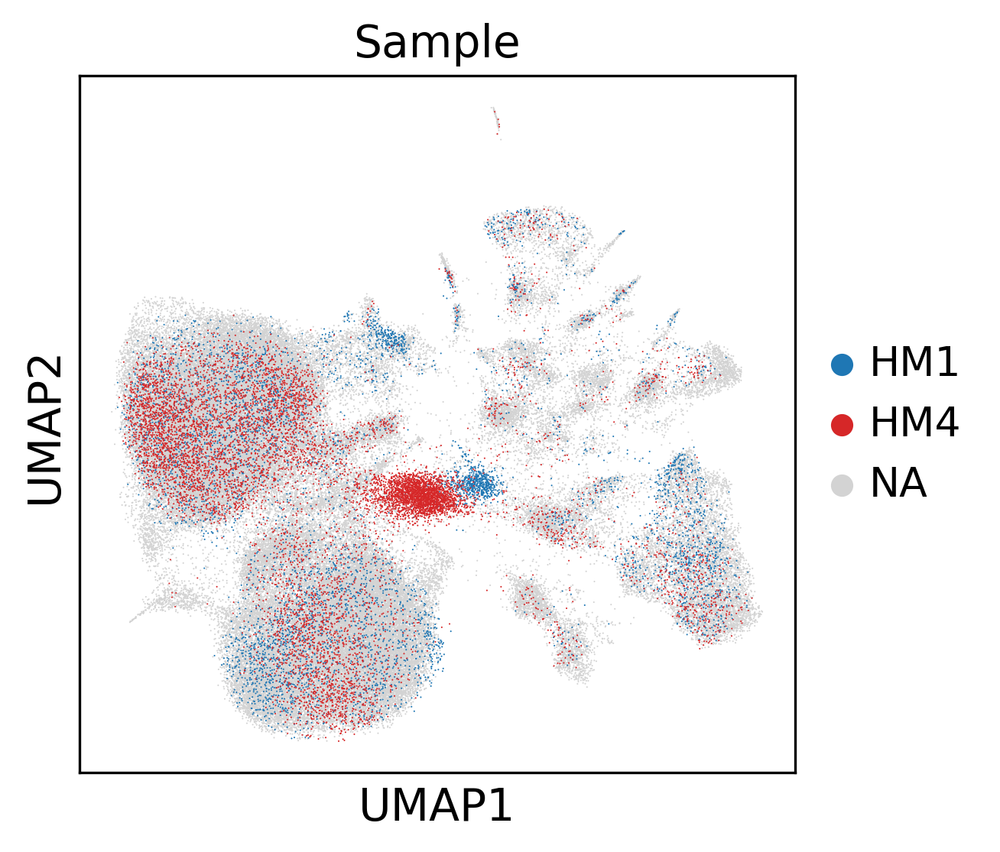

In [28]:
sc.pl.umap(adata_scvi, color = ['Sample'], groups = ['HM1', 'HM4'])

In [21]:
adata_scvi.uns=vae.adata.uns.copy()

In [22]:
sc.tl.leiden(adata_scvi, resolution = 1.6, key_added = "leiden_r1.6")
sc.tl.leiden(adata_scvi, resolution = 2, key_added = "leiden_r2")
sc.tl.leiden(adata_scvi, resolution = 3, key_added = "leiden_r3")

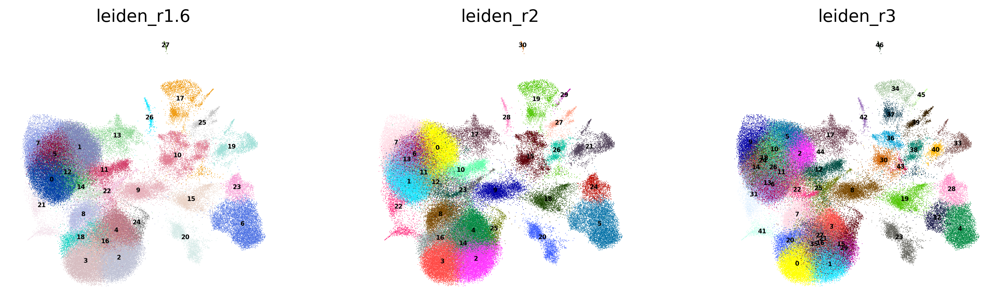

In [38]:
sc.pl.umap(adata_scvi, color = ["leiden_r1.6", "leiden_r2", "leiden_r3"], legend_loc = "on data", 
          legend_fontsize = 5, frameon = False)

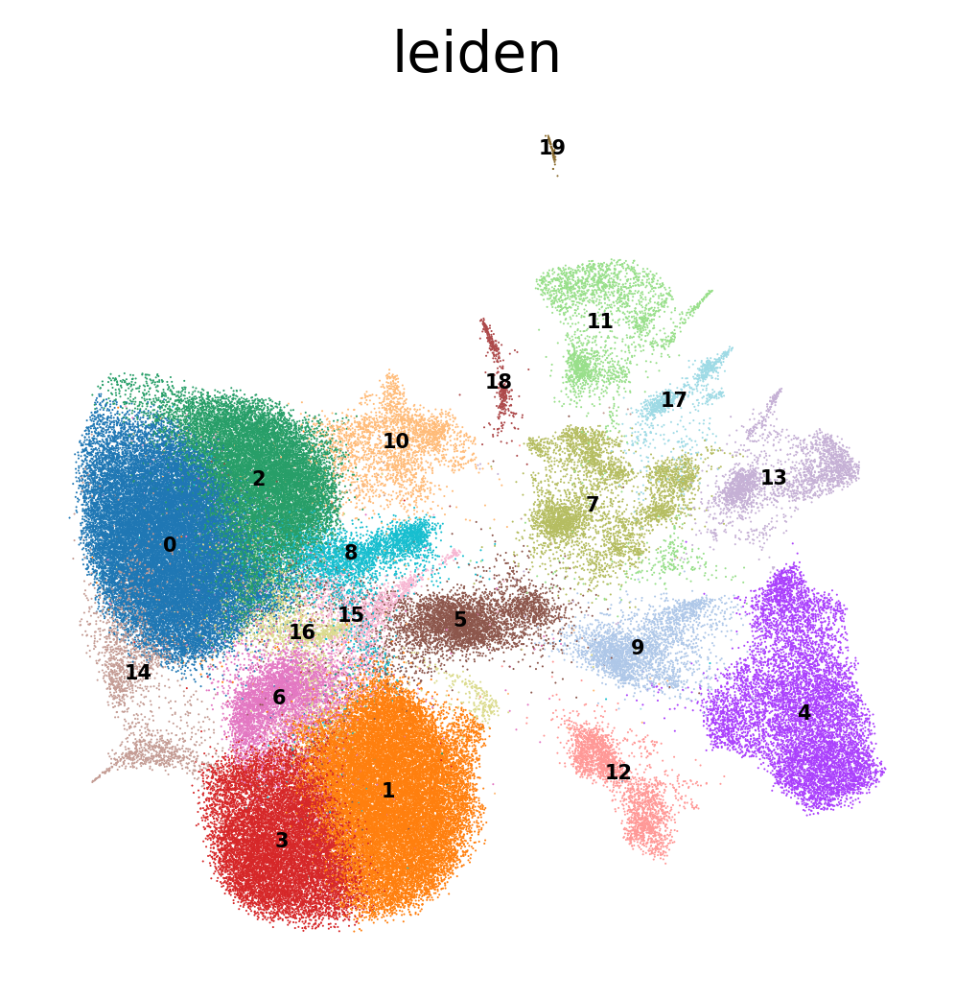

In [55]:
sc.pl.umap(adata_scvi, color = ['leiden'], legend_loc = "on data", 
          legend_fontsize = 5, frameon = False)

In [56]:
sc.tl.leiden(adata_scvi, resolution = 0.6, restrict_to=['leiden', ['7']], key_added = "leiden_r")
sc.tl.leiden(adata_scvi, resolution = 0.4, restrict_to=['leiden_r', ['9']], key_added = "leiden_r")
sc.tl.leiden(adata_scvi, resolution = 0.4, restrict_to=['leiden_r', ['13']], key_added = "leiden_r")
sc.tl.leiden(adata_scvi, resolution = 0.4, restrict_to=['leiden_r', ['11']], key_added = "leiden_r")
sc.tl.leiden(adata_scvi, resolution = 0.4, restrict_to=['leiden_r', ['5']], key_added = "leiden_r")
sc.tl.leiden(adata_scvi, resolution = 0.2, restrict_to=['leiden_r', ['14']], key_added = "leiden_r")

In [59]:
sc.tl.leiden(adata_scvi, resolution = 0.2, restrict_to=['leiden_r', ['12']], key_added = "leiden_r")
sc.tl.leiden(adata_scvi, resolution = 0.2, restrict_to=['leiden_r', ['16']], key_added = "leiden_r")
sc.tl.leiden(adata_scvi, resolution = 0.2, restrict_to=['leiden_r', ['17']], key_added = "leiden_r")
sc.tl.leiden(adata_scvi, resolution = 0.2, restrict_to=['leiden_r', ['18']], key_added = "leiden_r")

In [62]:
len(adata_scvi.obs['leiden_r'].cat.categories)

55

In [77]:
adata_scvi.obs['leiden_r'].cat.categories = [str(x).zfill(1) for x in range(55)]

In [82]:
adata_scvi.obs['leiden_r'].value_counts()

0     27469
1     23101
2     15216
3     12433
4      8362
8      4479
19     3751
5      3447
24     2570
44     1883
20     1485
45     1413
33     1265
42     1233
9      1218
6      1077
36     1056
34     1041
37      867
25      802
26      765
10      723
43      700
21      669
27      540
11      519
12      493
48      462
49      359
22      342
13      327
46      273
14      255
38      238
15      235
28      216
16      215
52      206
23      202
53      192
47      126
50      116
29      111
17       93
39       90
54       64
30       64
40       50
18       44
31       31
51       24
32       22
41       19
35       15
7         4
Name: leiden_r, dtype: int64

In [80]:
sc.tl.leiden(adata_scvi, resolution = 0.4, restrict_to=['leiden_r', ['1']], key_added = "leiden_r2")
sc.tl.leiden(adata_scvi, resolution = 0.2, restrict_to=['leiden_r2', ['24']], key_added = "leiden_r2")
sc.tl.leiden(adata_scvi, resolution = 0.2, restrict_to=['leiden_r2', ['19']], key_added = "leiden_r2")
sc.tl.leiden(adata_scvi, resolution = 0.4, restrict_to=['leiden_r2', ['4']], key_added = "leiden_r2")

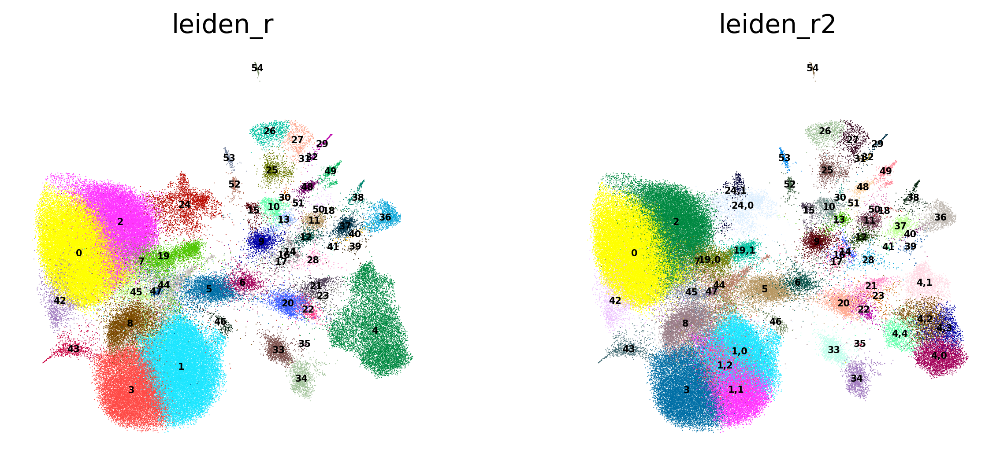

In [81]:
sc.pl.umap(adata_scvi, color = [ "leiden_r", 'leiden_r2'], legend_loc = "on data", 
          legend_fontsize = 5, frameon = False)

In [102]:
adata_scvi.obs.columns

Index(['SampleID', 'barcode', 'concat_sample_no', 'Sample', 'Batch',
       'Age_group', 'Tissue', 'Age', 'Filename', 'n_counts', 'n_counts_raw',
       'percent_soup', 'n_counts_spliced', 'n_counts_unspliced',
       'percent_spliced', 'n_genes', 'percent_mito', 'percent_ribo',
       'percent_hb', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval',
       'is_doublet', 'S_score', 'G2M_score', 'phase', 'leiden', 'leiden_r1.6',
       'leiden_r2', 'leiden_r3', 'fine_predicted_labels',
       'fine_over_clustering', 'fine_majority_voting', 'fine_conf_score',
       'coarse_predicted_labels', 'coarse_over_clustering',
       'coarse_majority_voting', 'coarse_conf_score', 'leiden_r'],
      dtype='object')

In [29]:
import celltypist
import time
# CellTypist prediction without over-clustering and majority-voting.
t_start = time.time()
predictions_cells_fine = celltypist.annotate(adata_scvi, model = '/nfs/team205/vk8/processed_data/muscle/data_v3/Celltypist_mod_icmSKM_nuclei_fine_new_2023-05-04.pkl', 
                                 majority_voting = True)
t_end = time.time()
print(f"Time elapsed: {t_end - t_start} seconds")
adata_scvi = predictions_cells_fine.to_adata(prefix = 'fine_')

# CellTypist prediction without over-clustering and majority-voting.
t_start = time.time()
predictions_cells_coarse = celltypist.annotate(adata_scvi, model = '/nfs/team205/vk8/processed_data/muscle/data_v3/Celltypist_mod_icmSKM_nuclei_coarse_2023-03-06.pkl', 
                                 majority_voting = True)
t_end = time.time()
print(f"Time elapsed: {t_end - t_start} seconds")
adata_scvi = predictions_cells_coarse.to_adata(prefix = 'coarse_')

🔬 Input data has 122972 cells and 33538 genes
🔗 Matching reference genes in the model
🧬 7700 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 25
🗳️ Majority voting the predictions
✅ Majority voting done!
🔬 Input data has 122972 cells and 33538 genes
🔗 Matching reference genes in the model


Time elapsed: 213.48527717590332 seconds


🧬 7542 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 25
🗳️ Majority voting the predictions
✅ Majority voting done!


Time elapsed: 207.89106822013855 seconds


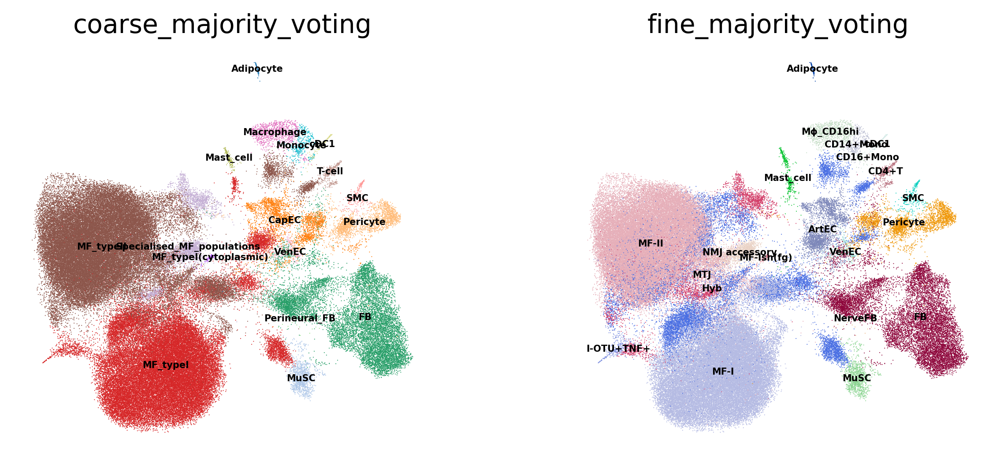

In [30]:
sc.pl.umap(adata_scvi, color = ["coarse_majority_voting", "fine_majority_voting"], legend_loc = "on data", 
          legend_fontsize = 5, frameon = False)

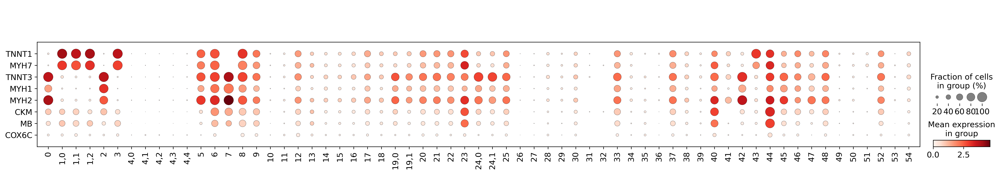

In [88]:
dp = sc.pl.dotplot(adata_scvi, groupby = "leiden_r2", var_names = ['TNNT1',
 'MYH7',
 'TNNT3',
 'MYH1',
 'MYH2',
 'CKM',
 'MB',
 'COX6C'], swap_axes = True)

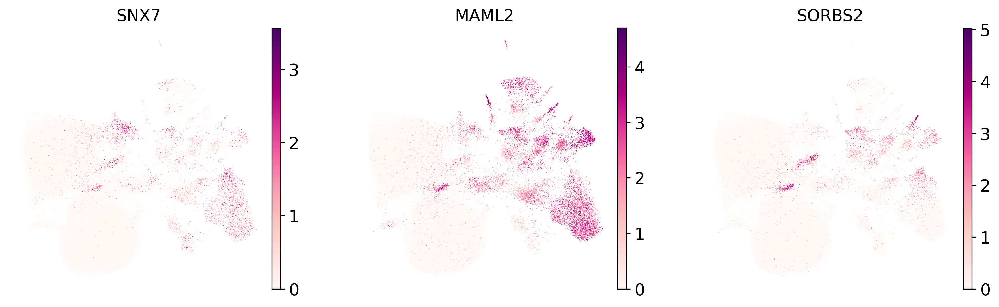

In [92]:
sc.pl.umap(adata_scvi, color = [ "SNX7", "MAML2", "SORBS2"], groups = ['44', '45', '47'], frameon = False)

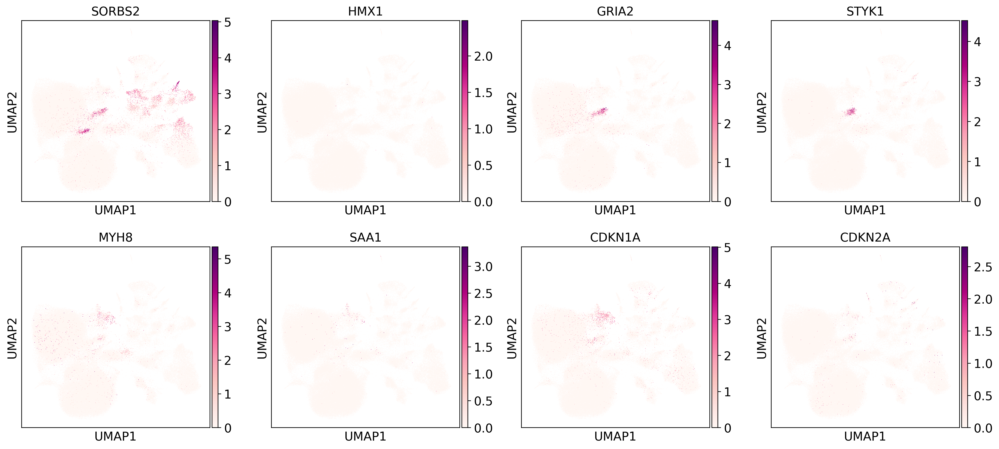

In [15]:
sc.pl.umap(adata_scvi, color = ['SORBS2', 'HMX1', 'GRIA2', 'STYK1', 'MYH8', 'SAA1', 'CDKN1A', 'CDKN2A'])

In [136]:
adata_scvi.obs['manual_anno'] = adata_scvi.obs.apply(lambda x:
                                                    'MF-I' if x["leiden_r"] in ['1', '3'] else
                                                    'MF-II' if x["leiden_r"] in ['0', '2'] else
                                                    'I-OTU+TNF+' if x["leiden_r"] == '43' else
                                                    'II-OTU+TNF+' if x["leiden_r"] == '42' else
                                                    'Hyb-doublet' if x["leiden_r"] == '8' else
                                                    'MTJ' if x["leiden_r"] =='47' else
                                                    'Cyt' if x["leiden_r"] == '44' else
                                                    'Soup1' if x["leiden_r"] == '5' else
                                                     'Soup2' if x["leiden_r"] == '6' else
                                                     'MYH8+' if x["leiden_r"] == '24' else
                                                     'NMJ accessory' if x["leiden_r"] == '19' else
                                                     'MuSC' if x["leiden_r"] in ["34", "35"] else
                                                     'MuSC_doublet' if x["leiden_r"]=='33' else
                                                     'Mast' if x["leiden_r"]=='53' else
                                                     'Mast_doublet' if x["leiden_r"]=='52' else
                                                     'FB_doublet1' if x["leiden_r"] in ['20', '22'] else
                                                     'FB_doublet2' if x["leiden_r"] in ['21', '23'] else
                                                     'FB' if x["leiden_r"] == '4' else
                                                     'Myeloid_doublet' if x["leiden_r"] == '25' else
                                                     'Lymphoid_doublet' if x["leiden_r"] == '48' else
                                                     'Art_doublet' if x["leiden_r"] == '9' else
                                                     'Pc_doublet' if x["leiden_r"] in ['12', '17'] else
                                                     'SMC_doublet' if x["leiden_r"] in ['37', '40'] else
                                                     x["fine_majority_voting"], axis = 1
                                                    )

... storing 'manual_anno' as categorical


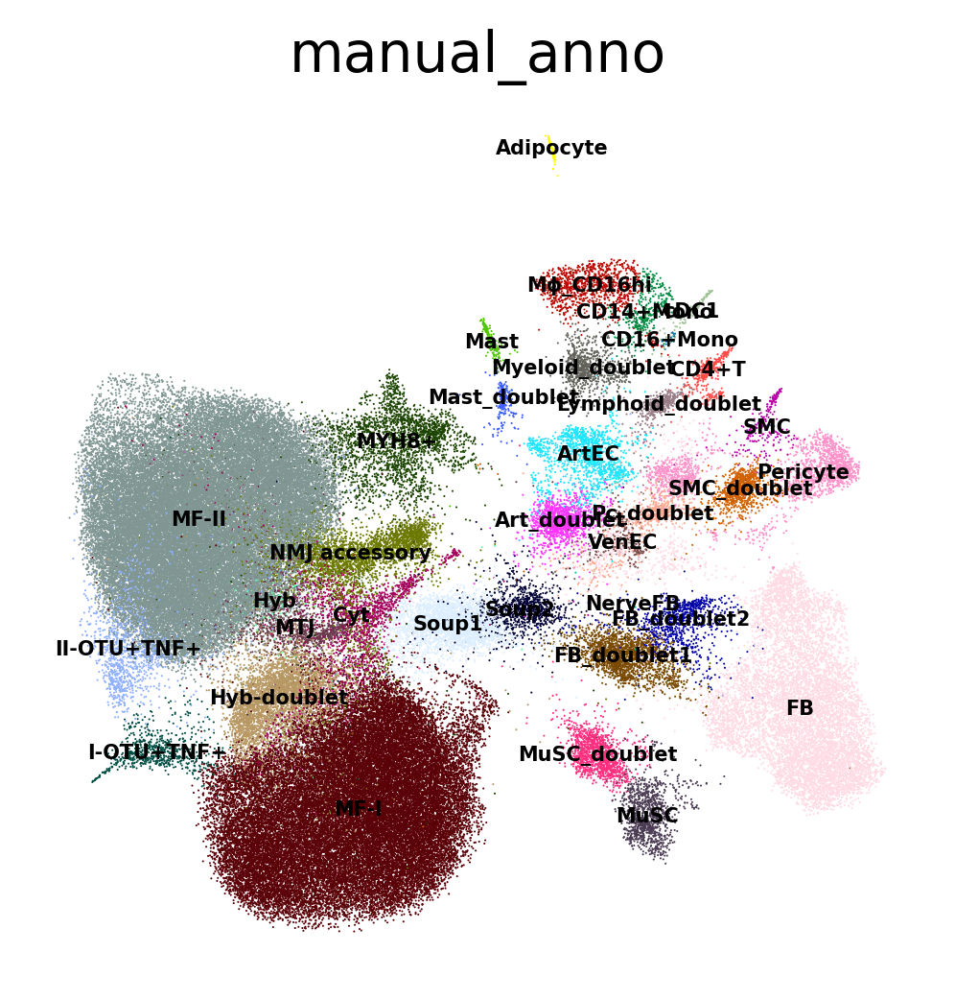

In [138]:
sc.pl.umap(adata_scvi, color = ["manual_anno"], legend_loc = "on data", 
          legend_fontsize = 5, frameon = False)

In [139]:
doublets = [i for i in adata_scvi.obs['manual_anno'].cat.categories if 'doublet' in i]

In [140]:
doublets = doublets + ['Soup1', 'Soup2', 'Cyt']

In [150]:
adata_scvi.write(f"SKM_nuclei_Perez2022_raw_scvi_annot_{today}.h5ad")

In [141]:
adata_scvi_dbrm = adata_scvi[~adata_scvi.obs['manual_anno'].isin(doublets),:].copy()

In [152]:
adata_scvi_dbrm.write(f"SKM_nuclei_Perez2022_raw_scvi_annot_dbrm_{today}.h5ad")

10009
INFO     Using batches from adata.obs["SampleID"]                                            


Using batches from adata.obs["SampleID"]


INFO     No label_key inputted, assuming all cells have same label                           


No label_key inputted, assuming all cells have same label


INFO     Using data from adata.X                                                             


Using data from adata.X


INFO     Successfully registered anndata object containing 103932 cells, 9961 vars, 17       
         batches, 1 labels, and 0 proteins. Also registered 1 extra categorical covariates   
         and 1 extra continuous covariates.                                                  


Successfully registered anndata object containing 103932 cells, 9961 vars, 17 batches, 1 labels, and 0 proteins. Also registered 1 extra categorical covariates and 1 extra continuous covariates.


INFO     Please do not further modify adata until model is trained.                          


Please do not further modify adata until model is trained.
GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 300/300: 100%|██████████| 300/300 [38:47<00:00,  7.76s/it, loss=1.57e+03, v_num=1]


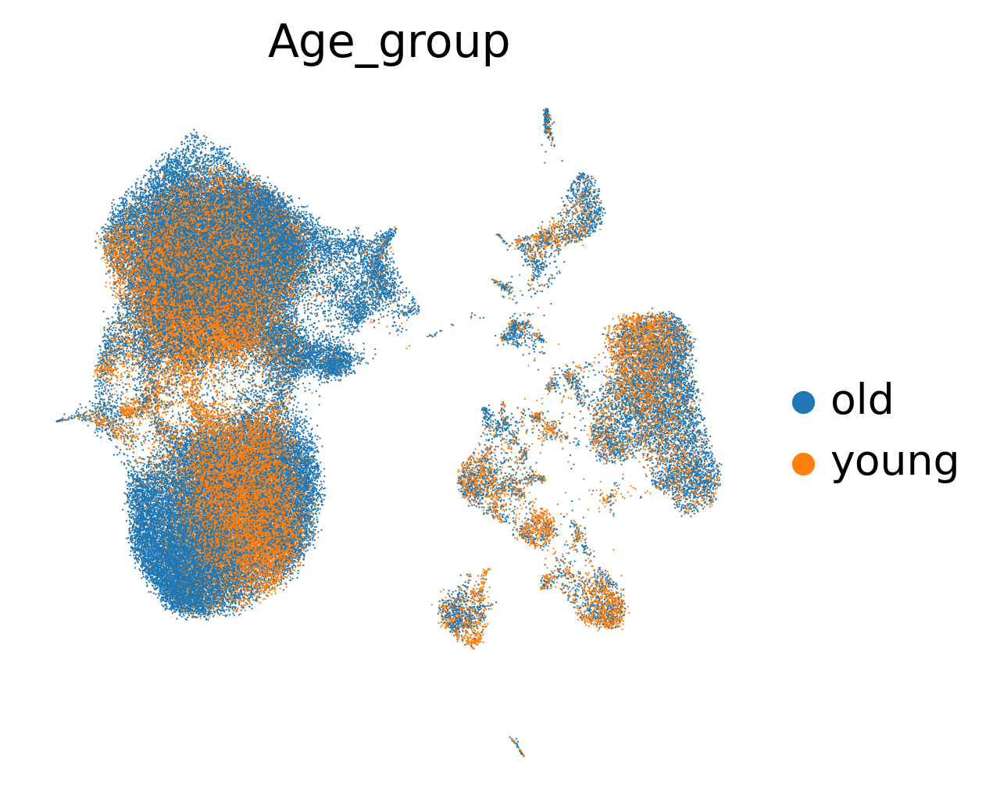

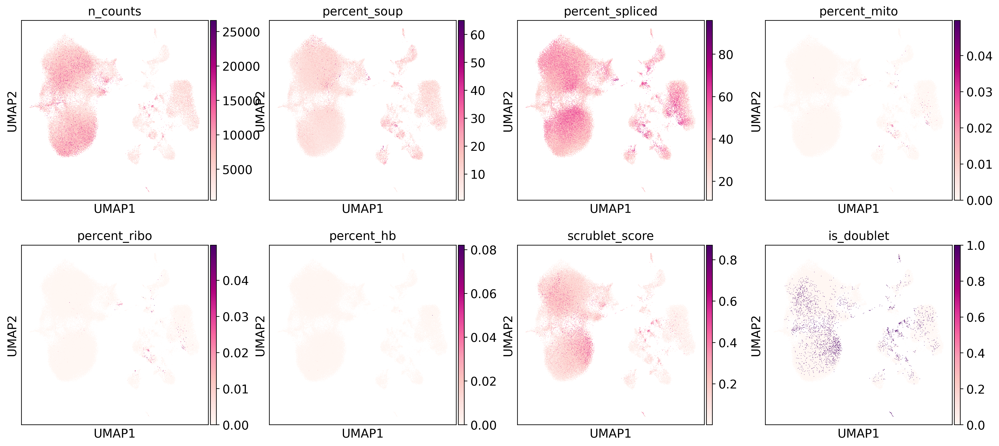

In [155]:
scvi_run2 = run_scvi(adata_scvi_dbrm, batch_hv = "Age_group", batch_scvi = "SampleID", \
             cat_cov_scvi = ["Age_group"], cont_cov_scvi = ["percent_mito"], \
             include_genes = myofiber_mrkrs, exclude_cc_genes=True, exclude_mt_genes = True,
             vae_name = "Myofiber_nuclei_Perez", n_layers=2, n_latent=30, max_epochs=300)

In [157]:
adata_scvi2 = scvi_run2['data']

In [161]:
adata_scvi2.uns['neighbors'] = scvi_run2['vae'].adata.uns['neighbors'].copy()

In [162]:
import celltypist
import time
# CellTypist prediction without over-clustering and majority-voting.
t_start = time.time()
predictions_cells_fine = celltypist.annotate(adata_scvi2, model = '/nfs/team205/vk8/processed_data/muscle/data_v3/Celltypist_mod_icmSKM_nuclei_fine_new_2023-05-04.pkl', 
                                 majority_voting = True)
t_end = time.time()
print(f"Time elapsed: {t_end - t_start} seconds")
adata_scvi2 = predictions_cells_fine.to_adata(prefix = 'fine2_')

# CellTypist prediction without over-clustering and majority-voting.
t_start = time.time()
predictions_cells_coarse = celltypist.annotate(adata_scvi2, model = '/nfs/team205/vk8/processed_data/muscle/data_v3/Celltypist_mod_icmSKM_nuclei_coarse_2023-03-06.pkl', 
                                 majority_voting = True)
t_end = time.time()
print(f"Time elapsed: {t_end - t_start} seconds")
adata_scvi2 = predictions_cells_coarse.to_adata(prefix = 'coarse2_')

🔬 Input data has 103932 cells and 33538 genes
🔗 Matching reference genes in the model
🧬 7700 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 25
🗳️ Majority voting the predictions
✅ Majority voting done!
🔬 Input data has 103932 cells and 33538 genes
🔗 Matching reference genes in the model


Time elapsed: 105.61612176895142 seconds


🧬 7542 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 25
🗳️ Majority voting the predictions
✅ Majority voting done!


Time elapsed: 107.72007012367249 seconds


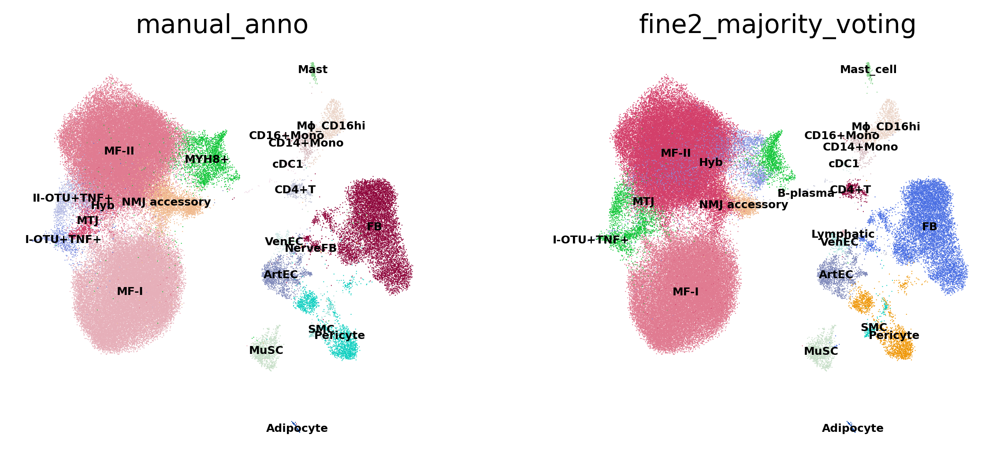

In [165]:
sc.pl.umap(adata_scvi2, color = ["manual_anno", "fine2_majority_voting"], legend_loc = "on data", 
          legend_fontsize = 6, frameon = False)

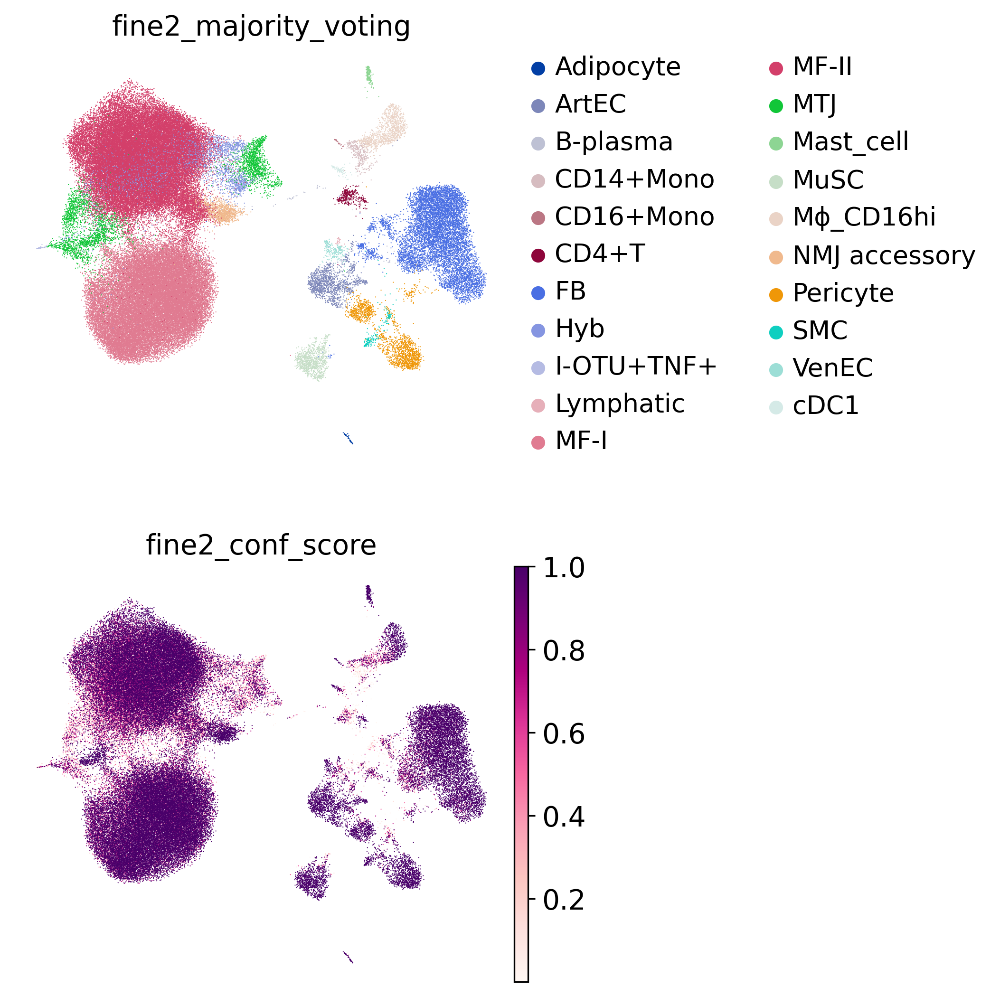

In [169]:
sc.pl.umap(adata_scvi2, color = ["fine2_majority_voting", 'fine2_conf_score'], ncols = 1, frameon = False)

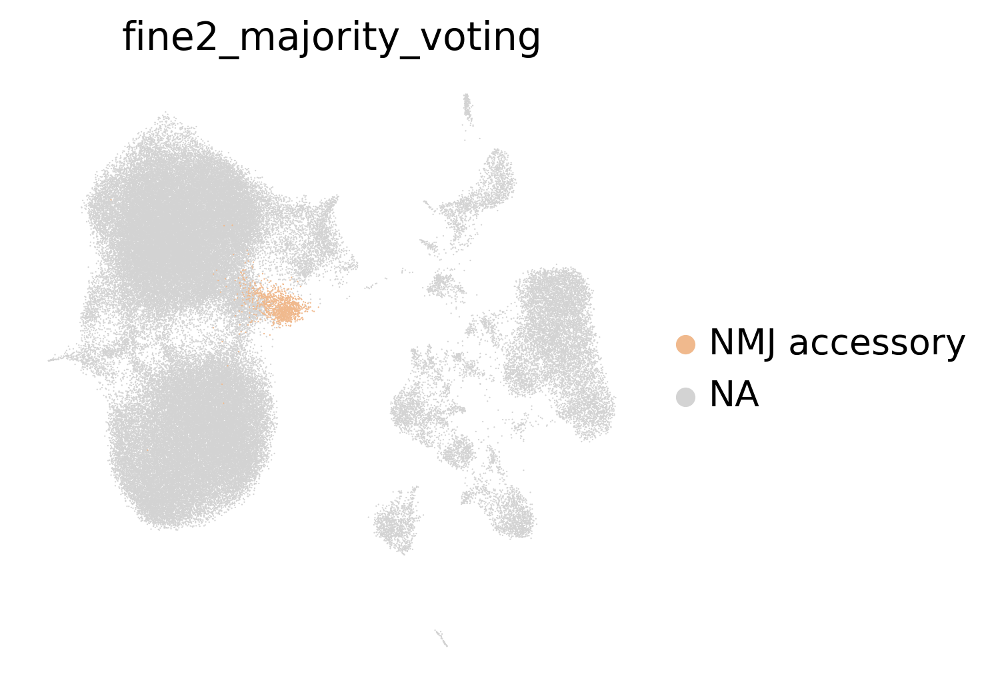

In [170]:
sc.pl.umap(adata_scvi2, color = ["fine2_majority_voting"], groups = ['NMJ accessory'], ncols = 1, frameon = False)

In [200]:
adata_scvi2.obs['manual_anno2'] = adata_scvi2.obs.apply(lambda x: x['manual_anno'] if x['manual_anno'] in ['I-OTU+TNF+', 'II-OTU+TNF+', 'MF-I', 'MF-II', 'MTJ', 'MYH8+'] 
                                                        else x['fine2_majority_voting'], axis = 1)

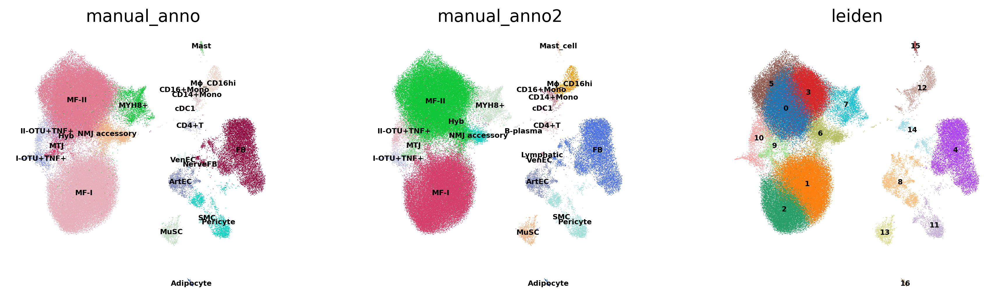

In [202]:
sc.pl.umap(adata_scvi2, color = ["manual_anno", "manual_anno2", "leiden"], legend_loc = "on data", 
          legend_fontsize = 6, frameon = False)

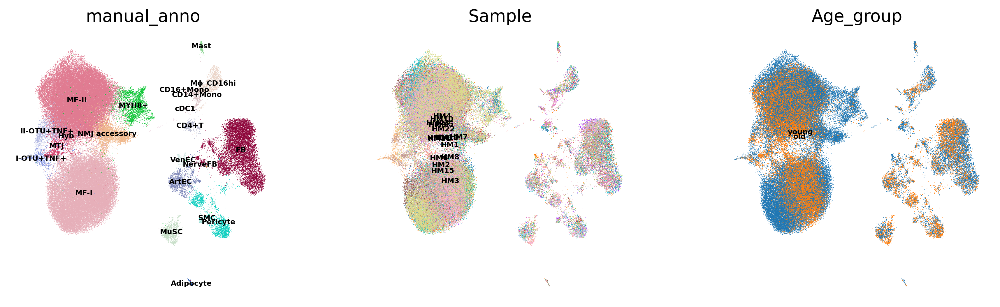

In [291]:
sc.pl.umap(adata_scvi2, color = ["manual_anno", "Sample", "Age_group"], legend_loc = "on data", 
          legend_fontsize = 6, frameon = False)

In [293]:
adata_scvi2.obs["manual_anno2"]=adata_scvi2.obs["manual_anno2"].apply(lambda x: 'FB' if x == 'NerveFB' else x)

In [220]:
def scvi_markers(vae, cluster, n_markers=5):
    results = {}
    de_df = vae.differential_expression(
    groupby=cluster)
    de_df['cluster'] = [i.replace(" vs Rest","") for i in de_df['comparison']]
    de_df.head()
    markers = {}
    cats = vae.adata.obs[cluster].cat.categories
    for i, c in enumerate(cats):
        cid = "{} vs Rest".format(c)
        cell_type_df = de_df.loc[de_df.comparison == cid]
        cell_type_df = cell_type_df[cell_type_df.lfc_mean > 1]
        cell_type_df = cell_type_df[cell_type_df["bayes_factor"] > 2]
        cell_type_df = cell_type_df[cell_type_df["non_zeros_proportion1"] > 0.1]
        markers[c] = cell_type_df.index.tolist()[:n_markers]
    results['de_df'] = de_df
    results['markers'] = markers
    #print(results)
    return(results)

In [223]:
vae2 = scvi_run2['vae']

In [226]:
vae2.adata.obs['manual_anno2'] = adata_scvi2.obs.reindex(vae2.adata.obs_names)['manual_anno2'].copy()

In [227]:
vae_mrkrs = scvi_markers(vae2,'manual_anno2' )

DE...: 100%|██████████| 23/23 [05:06<00:00, 13.32s/it]


In [236]:
mrkrs_tb = vae_mrkrs['de_df'].copy()
mrkrs_tb.loc[(mrkrs_tb['cluster'] == 'NMJ accessory') & (mrkrs_tb['bayes_factor'] >3)].index.tolist()

['STYK1',
 'APBA2',
 'AC097512.1',
 'AC007656.1',
 'AL445623.2',
 'LINC00589',
 'AC024022.1',
 'CPLX4',
 'LINC00563',
 'LINC02310',
 'AC129807.1',
 'GFRA1',
 'AL133163.2',
 'LINC01299',
 'SYT16',
 'DSG2-AS1',
 'LINC00836',
 'AC074237.1',
 'CDKL2',
 'AC093331.2',
 'AC116634.1',
 'AC069133.1',
 'AC097501.2',
 'LPAR3',
 'LINC02431',
 'AC108472.1',
 'LINC02150',
 'MARCH11',
 'MAN1A1',
 'AC079340.1',
 'PSMA8',
 'AC078923.1',
 'AP001025.1',
 'AC090155.1',
 'SLC14A1',
 'HTR3D',
 'PLA2G12B',
 'AC103764.1',
 'LINC01181',
 'AL049649.1',
 'DPYSL2',
 'AC004990.1',
 'FLT3',
 'LINC01182',
 'ZFR2',
 'AC068672.2',
 'CYTIP',
 'SLC7A13',
 'ERICH5',
 'AL138694.1',
 'LINC02491',
 'PSKH2',
 'AC022335.1',
 'CER1',
 'KCNQ2',
 'TACC1',
 'LINC02272',
 'AC008592.4',
 'FRRS1L',
 'LINC00557',
 'AC105362.1',
 'TUSC8',
 'LGALS3',
 'CAV1',
 'LINC01500',
 'TTLL9',
 'SPARCL1',
 'EFNA2',
 'OR4C12',
 'AC090809.1',
 'AC023194.3',
 'IGFBP7',
 'AC011124.2',
 'AP003774.2',
 'OR5C1',
 'ADAMTS12',
 'PLTP',
 'LINC02469',
 'AC1

In [270]:
myofiber_nmj_acc_enrich_df = sc.queries.enrich(mrkrs_tb.loc[(mrkrs_tb['cluster'] == 'NMJ accessory') & (mrkrs_tb['bayes_factor'] >3)].index.tolist(),gprofiler_kwargs={'sources': ['GO:BP', 'REAC', 'KEGG'], 'no_evidences': False, 'all_results': True}, org="hsapiens")
myofiber_nmj_acc_enrich_df.significant = myofiber_nmj_acc_enrich_df.p_value<0.1
myofiber_nmj_acc_enrich_df.significant.sum()

789

In [273]:
nmj_enriched = myofiber_nmj_acc_enrich_df.loc[(myofiber_nmj_acc_enrich_df['term_size']<500) &
                              (myofiber_nmj_acc_enrich_df['significant']==True)]

In [275]:
nmj_enriched.shape

(522, 16)

In [279]:
synapse = [i for i in nmj_enriched['name'].unique() if 'synapse' in i ]

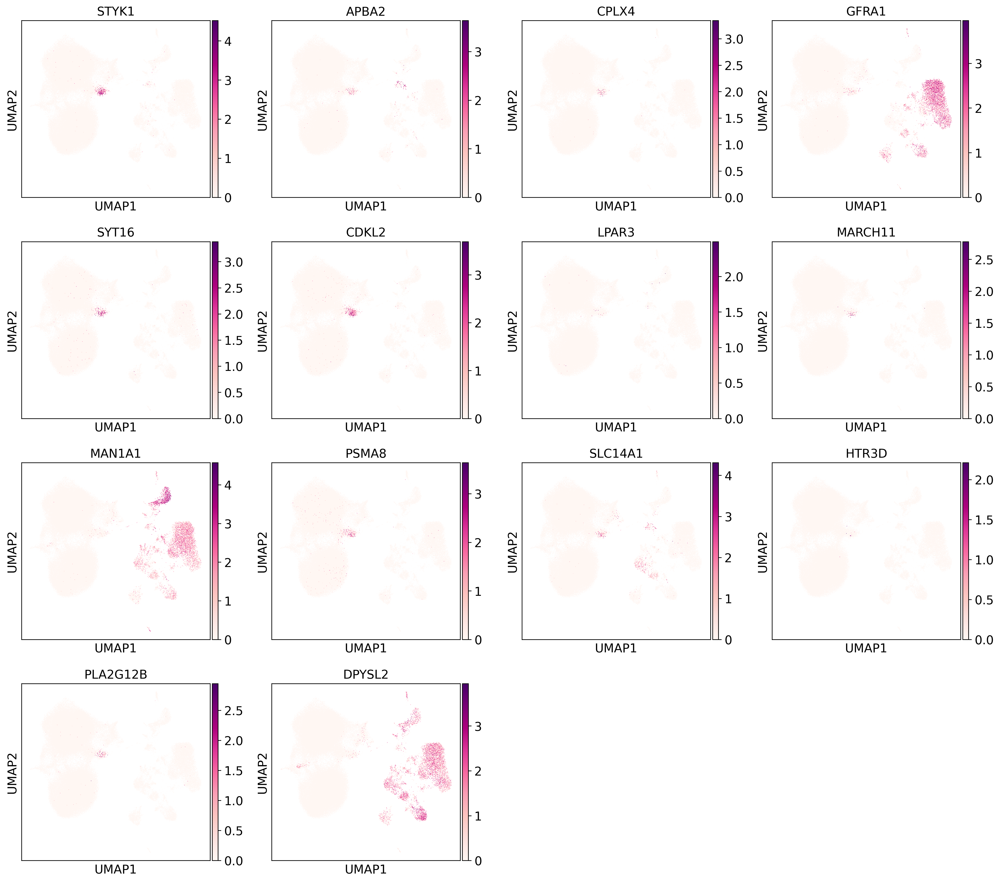

In [261]:
sc.pl.umap(adata_scvi2, color = ['STYK1','APBA2', 'CPLX4', 'SYT16', 'CDKL2', 'MARCH11',
 'PSMA8','PLA2G12B',])

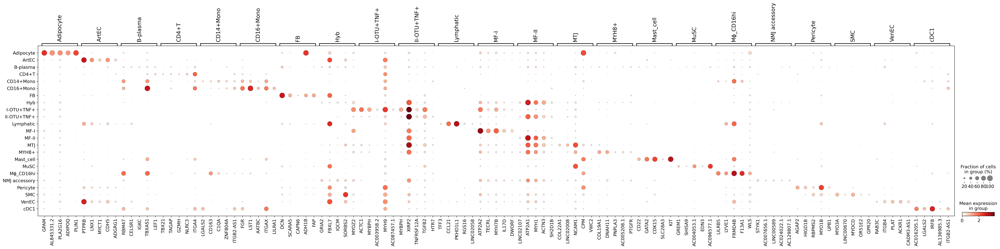

In [230]:
sc.pl.dotplot(adata_scvi2, groupby = ['manual_anno2'], var_names = vae_mrkrs['markers'])

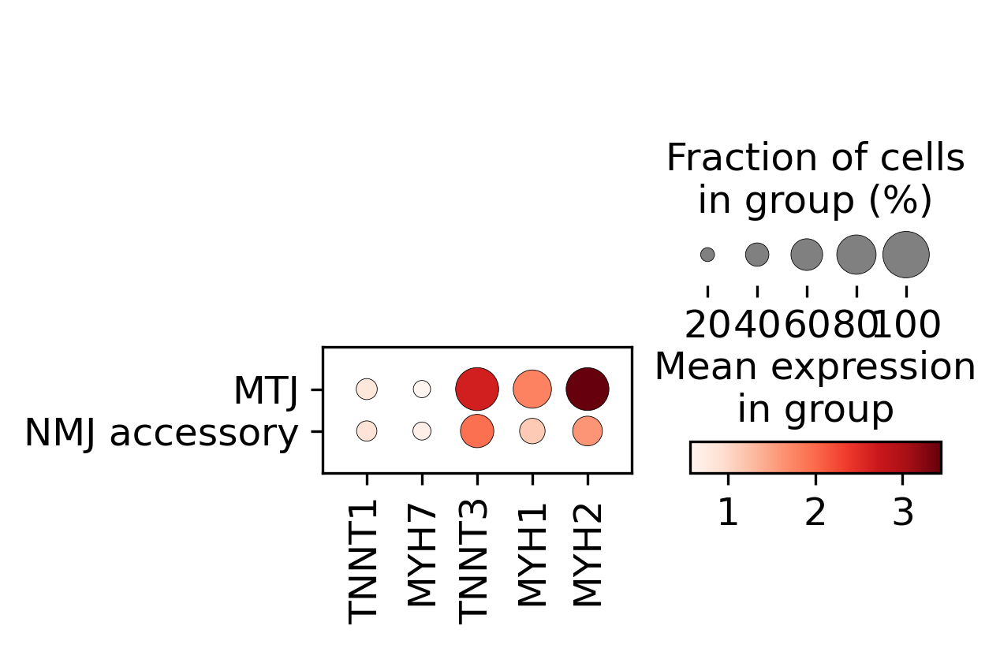

In [283]:
sc.pl.dotplot(adata_scvi2[adata_scvi2.obs['manual_anno2'].isin(['MTJ', "NMJ accessory"]),:], groupby = 'manual_anno2', 
              var_names = ['TNNT1', 'MYH7', 'TNNT3', 'MYH1', 'MYH2'])

In [288]:
adata_scvi2.write(f"SKM_nuclei_Perez2022_raw_scvi2_annot_dbrm_{today}.h5ad")
vae.save(f'{model_folder}/SKM_nuclei_Perez_scvi3_all_{today}',  save_anndata = True)
vae.save(f'{model_folder}/SKM_nuclei_Perez_scvi3_all_dbrm_{today}',  save_anndata = True)

In [6]:
model_folder

'/nfs/team205/vk8/scripts/scvi/Results/scvi_models/'